In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import shutil
from sklearn.cluster import KMeans
import pandas as pd

In [2]:
folder_path = '/kaggle/input/pananorma/panorama_dataset'
output_folder = './clustered_images' 

In [3]:
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

In [4]:
k=3
for i in range(k):
    cluster_folder = os.path.join(output_folder, f'cluster_{i + 1}')
    if not os.path.exists(cluster_folder):
        os.makedirs(cluster_folder)

In [5]:
histograms = []
images = []
prefix=[]

In [6]:
print(os.listdir(folder_path))

for file in os.listdir(folder_path):
    img = cv2.imread(os.path.join(folder_path, file))
    
    hsv_image = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    hist_hue = cv2.calcHist([hsv_image], [0], None, [32], [0, 256])
    hist_saturation = cv2.calcHist([hsv_image], [1], None, [32], [0, 256])
    f=len(images)
    hist_value = cv2.calcHist([hsv_image], [2], None, [32], [0, 256])
    
    hist = np.concatenate([hist_hue.flatten(), hist_saturation.flatten(), hist_value.flatten()])
    
    histograms.append(hist)
    images.append(img)


['r.png', 'd.png', 'n.png', 'b.png', 'p.png', 'm.png', 'q.png', 'l.png', 'u.png', 'f.png', 'e.png', 'image1.png', 'g.png', 'h.png', 'o.png', 'v.png', 'k.png', 'image2.png', 'i.png', 'a.png', 'c.png', 't.png', 's.png', 'j.png']


In [7]:
histograms = np.array(histograms)
predict=True
num_clusters = 3
kmeans = KMeans(n_clusters=num_clusters)
labels = kmeans.fit_predict(histograms)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [8]:
for i in range(num_clusters):
    cluster_folder = os.path.join(output_folder, f'cluster_{i + 1}')

    t=len(images)
    for j in range(t):
        if labels[j] == i:
            img_name = f'image_{j + 1}.png' 
            img_path = os.path.join(cluster_folder, img_name)
            cv2.imwrite(img_path, images[j])


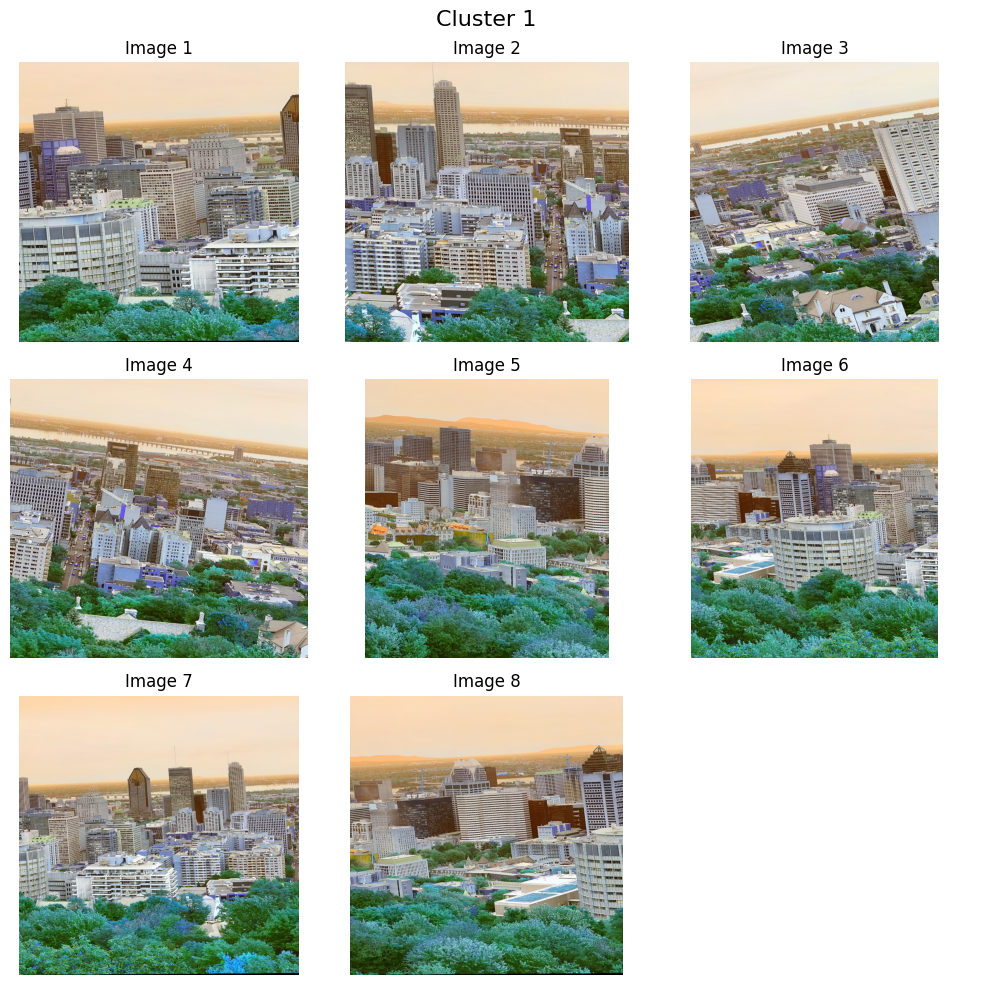

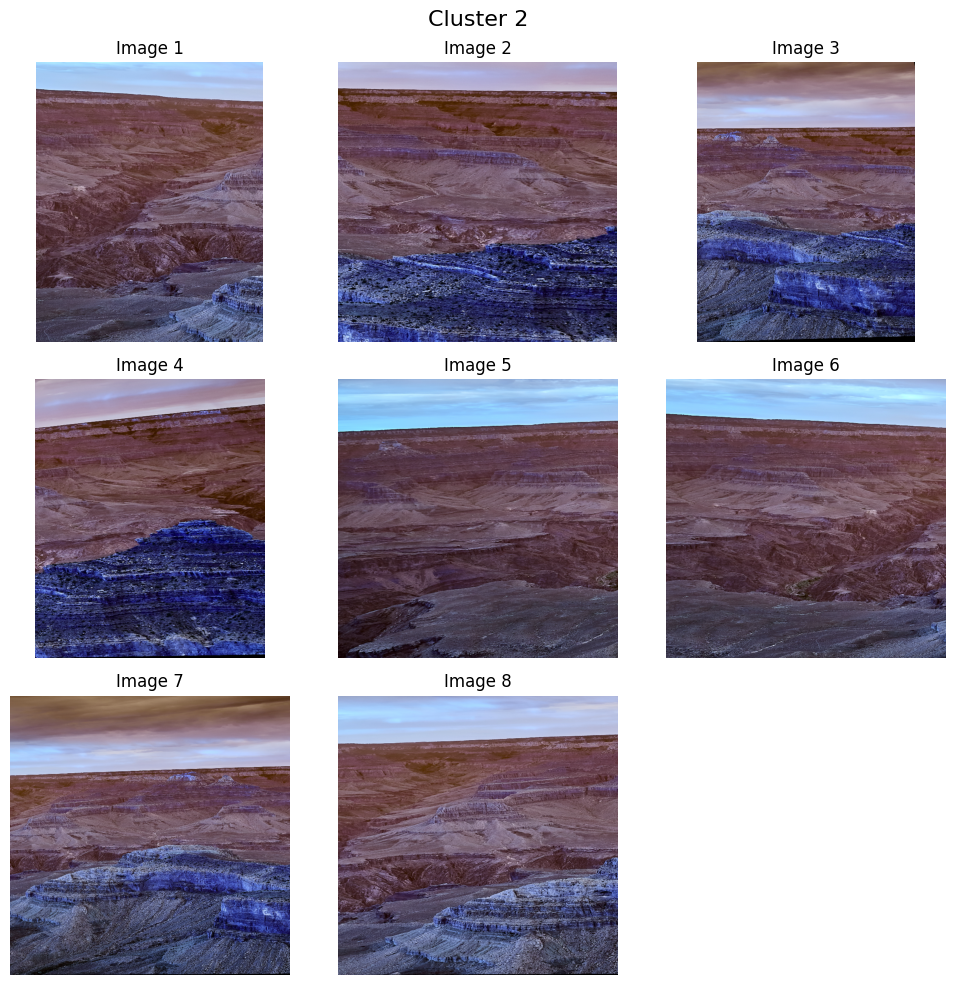

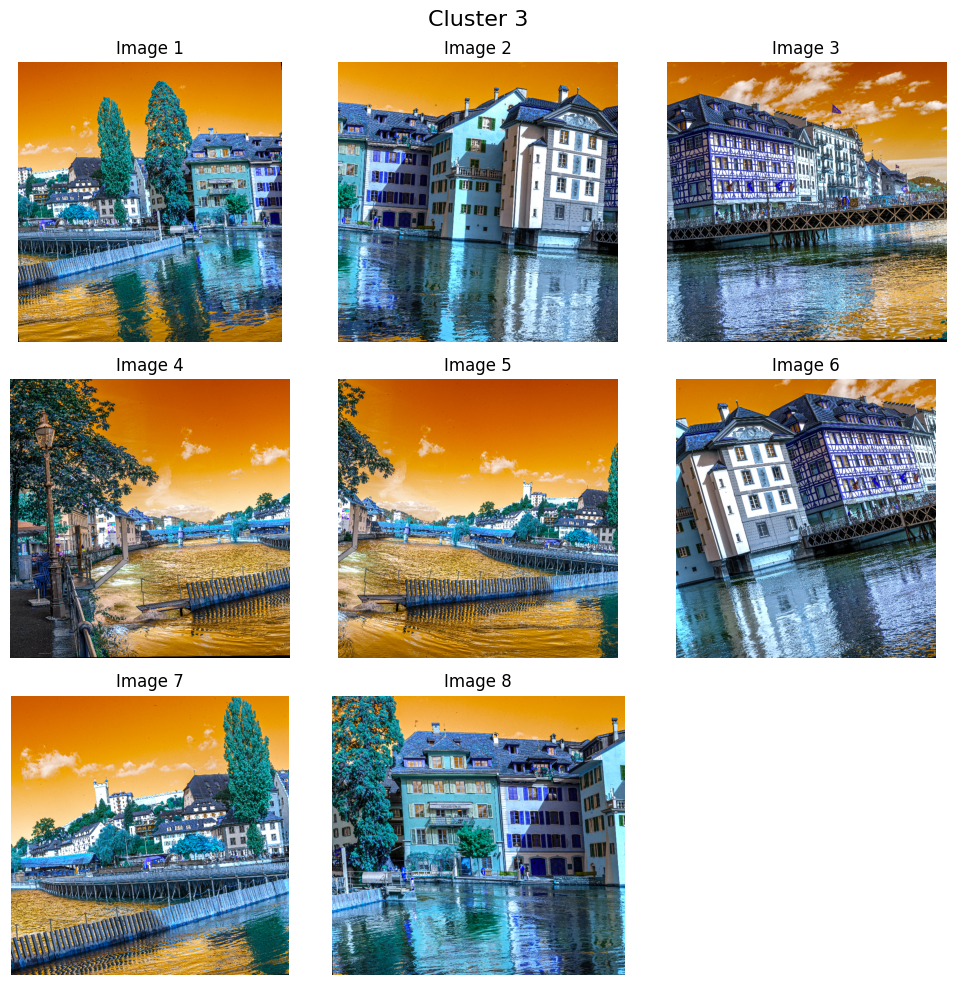

In [9]:
for i in range(num_clusters):
    cluster_images = []
    for j in range(len(images)):
        if labels[j] == i:
            cluster_images.append(images[j])
    num_images = len(cluster_images)
    cu=np.sqrt(num_images)
    cut=np.ceil(cu)
    
    grid_size = int(cut)

    fig, axes = plt.subplots(grid_size, grid_size, figsize=(10, 10))
    axes = axes.flatten() 

    for idx, ax in enumerate(axes):
        if idx < num_images:
            ax.imshow(cluster_images[idx]) 
            ax.set_title(f'Image {idx + 1}')
        ax.axis('off')  

    plt.suptitle(f'Cluster {i + 1}', fontsize=16)
    plt.tight_layout()
    plt.show()


In [10]:
orb = cv2.ORB_create()


In [11]:
descriptors_list = []
for img in images:
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    kp, des = orb.detectAndCompute(gray, None)
    li=len(descriptors_list)
    if des is not None:
        descriptors_list.append(des)

In [12]:
all_descriptors = np.vstack(descriptors_list)


In [13]:
num_visual_words = 101
kmeans = KMeans(n_clusters=num_visual_words, random_state=2022254)
kmeans.fit(all_descriptors)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=101, random_state=2022254)

In [14]:
image_histograms = []
for des in descriptors_list:
    words = kmeans.predict(des)
    li=len(image_histograms)
    hist, _ = np.histogram(words, bins=np.arange(num_visual_words + 1), range=(0, num_visual_words))
    image_histograms.append(hist)

In [15]:
image_histograms = np.array(image_histograms)


In [16]:
num_clusters = 3  
kmeans_images = KMeans(n_clusters=num_clusters, random_state=42)
labels = kmeans_images.fit_predict(image_histograms)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


**************************************************


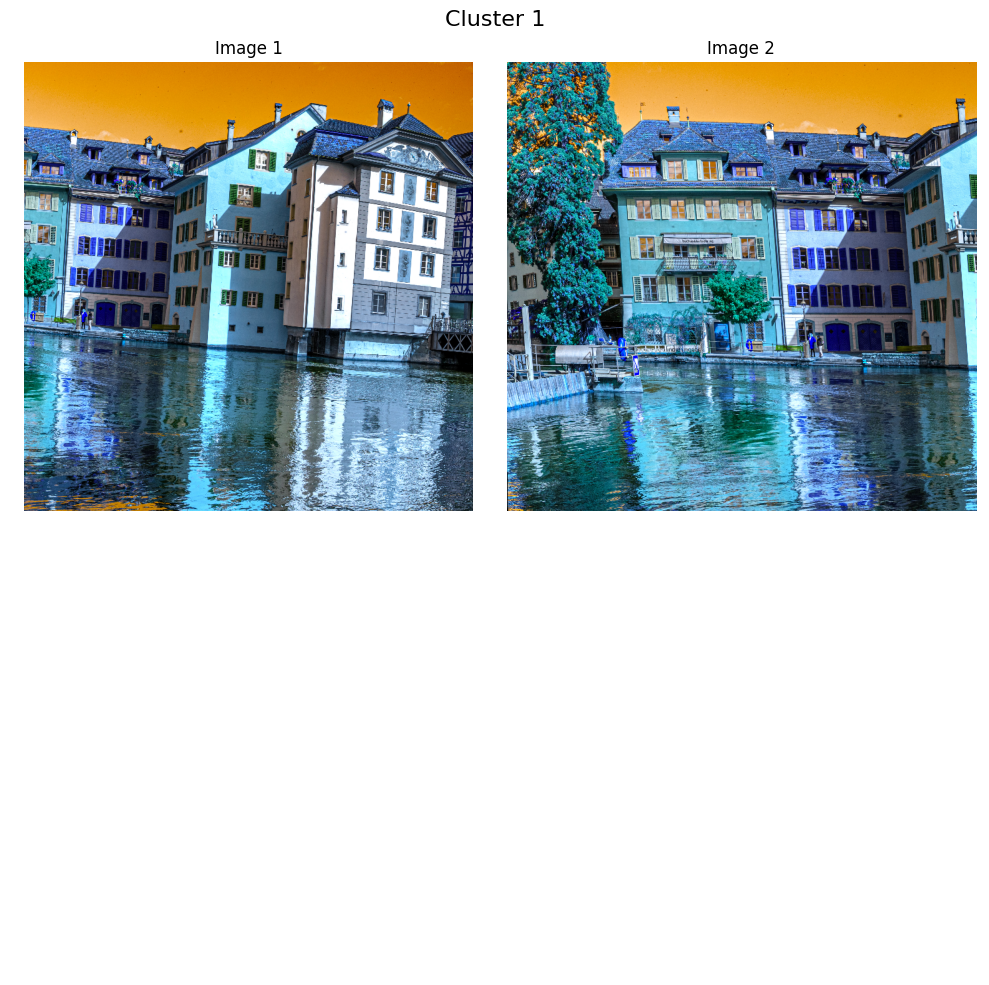

**************************************************


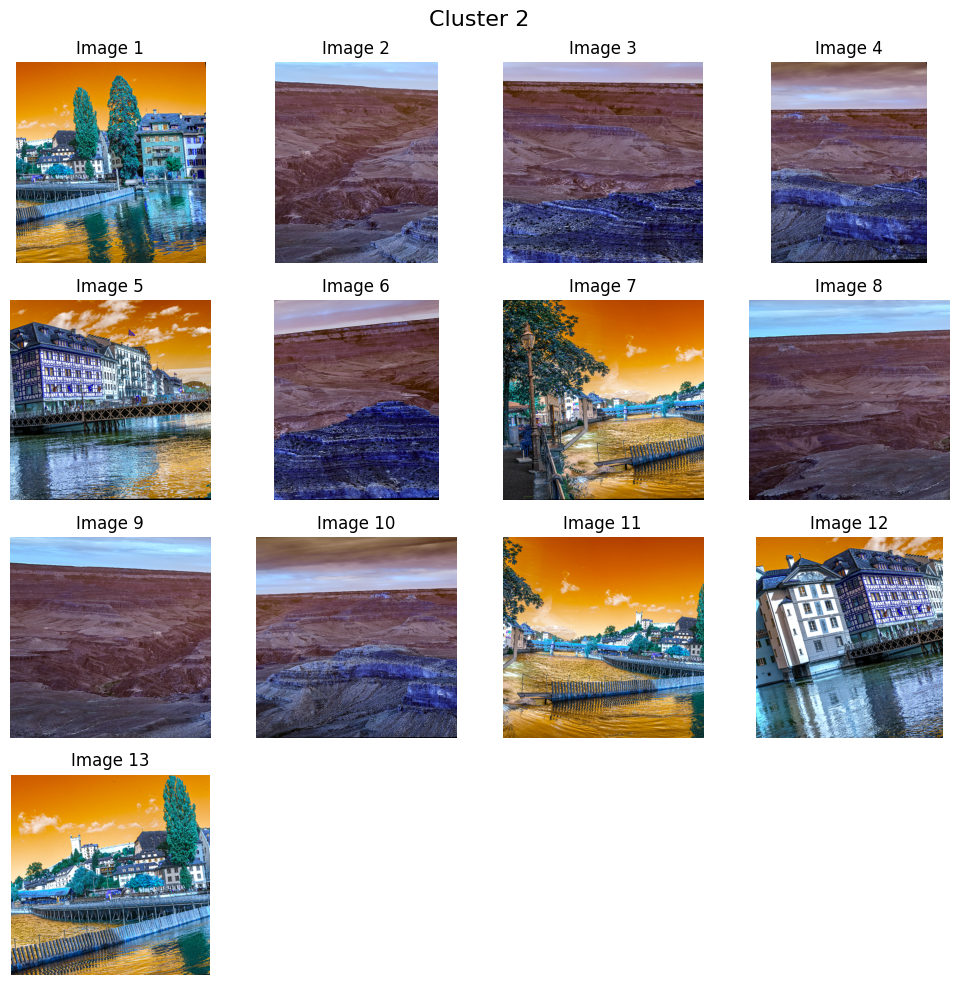

**************************************************


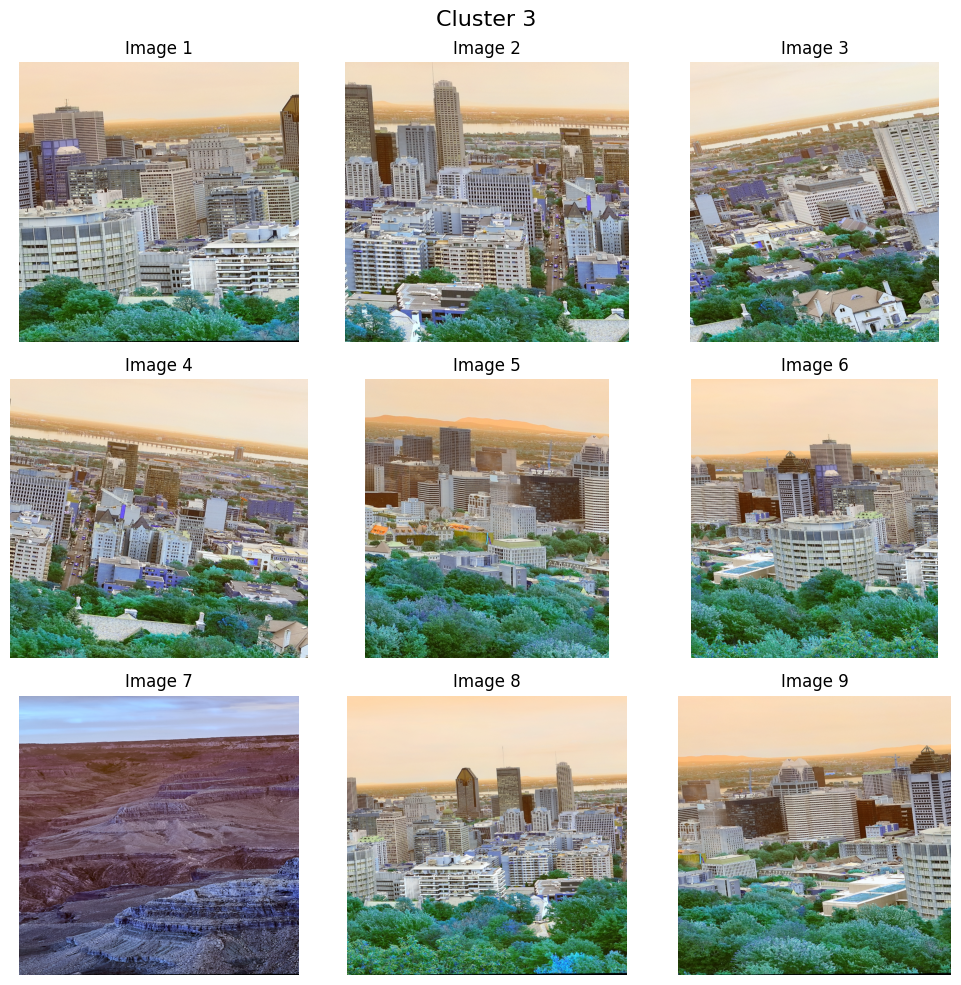

In [17]:
for i in range(num_clusters):
    cluster_images = [images[j] for j in range(len(images)) if labels[j] == i]
    
    num_images = len(cluster_images)
    cu=np.sqrt(num_images)
    grid_size = int(np.ceil(cu))  

    fig, axes = plt.subplots(grid_size, grid_size, figsize=(10, 10))
    axes = axes.flatten()  
    print("*"*50)
    for idx, ax in enumerate(axes):
        if idx < num_images:
            ax.imshow(cluster_images[idx])
            ax.set_title(f'Image {idx + 1}')
        ax.axis('off')  
    plt.suptitle(f'Cluster {i + 1}', fontsize=16)
    plt.tight_layout()
    plt.show()


In [18]:
image1 = cv2.imread('/kaggle/input/pananorma/panorama_dataset/image1.png') 
image2 = cv2.imread('/kaggle/input/pananorma/panorama_dataset/image2.png') 

In [19]:
gray_img1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
gray_img2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

In [20]:
sift = cv2.SIFT_create()
keypoints1, descriptors1 = sift.detectAndCompute(gray_img1, None)
keypoints2, descriptors2 = sift.detectAndCompute(gray_img2, None)

In [21]:
img1_keypoints = cv2.drawKeypoints(image1, keypoints1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2_keypoints = cv2.drawKeypoints(image2, keypoints2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)


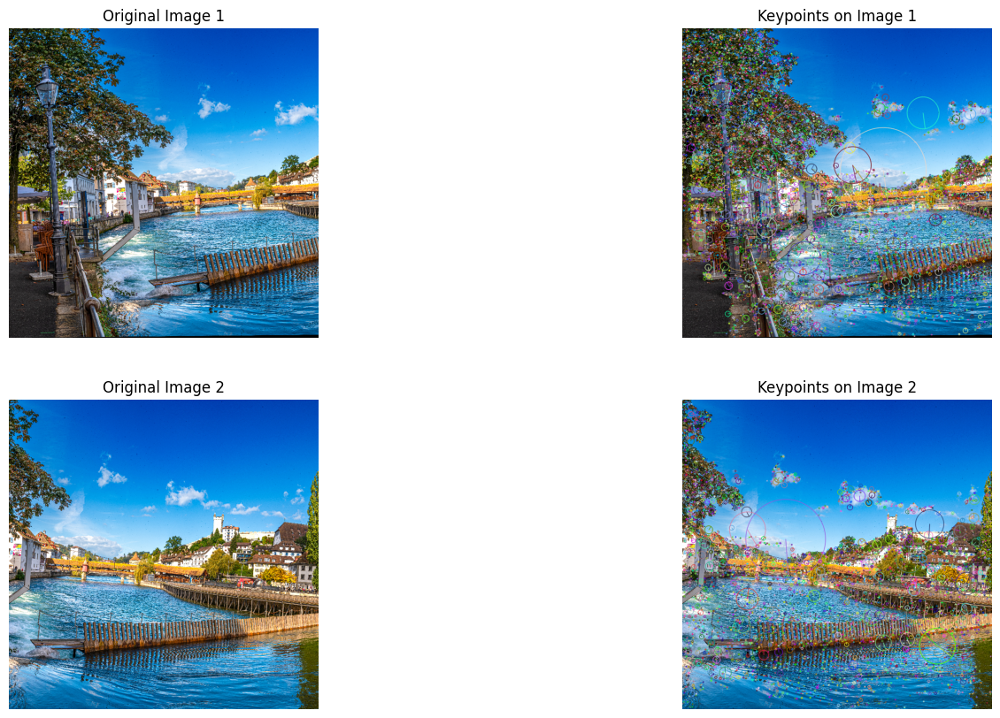

In [22]:
import cv2 as cv

plt.figure(figsize=(18, 10))

plt.subplot(2, 2, 1)
plt.imshow(cv.cvtColor(image1, cv.COLOR_BGR2RGB))
plt.title("Original Image 1")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(cv.cvtColor(img1_keypoints, cv.COLOR_BGR2RGB))
plt.title("Keypoints on Image 1")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(cv.cvtColor(image2, cv.COLOR_BGR2RGB))
plt.title("Original Image 2")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(cv.cvtColor(img2_keypoints, cv.COLOR_BGR2RGB))
plt.title("Keypoints on Image 2")
plt.axis("off")

plt.show()


In [23]:

bf_matcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
print(bf_matcher)
bf_matches = bf_matcher.match(descriptors1, descriptors2)

filtered_bf_matches = []
for match in bf_matches:
    if match.distance < 0.75 * bf_matches[1].distance:
        lm=len(filtered_bf_matches)
        filtered_bf_matches.append(match)

print(len(filtered_bf_matches))
bf_matched = cv2.drawMatches(image1, keypoints1, image2, keypoints2, filtered_bf_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


< cv2.BFMatcher 0x7b303f6c6f50>
874


In [24]:
flann_matcher = cv2.FlannBasedMatcher(dict(algorithm=1, trees=5), dict(checks=50))
flann_matches = flann_matcher.knnMatch(descriptors1, descriptors2, k=2)
print(len(filtered_bf_matches))

874


In [25]:
filtered_flann_matches = []
for m, n in flann_matches:
    if m.distance < 0.7 * n.distance:
        kt=len(filtered_flann_matches)
        filtered_flann_matches.append(m)
print(len(filtered_flann_matches))
flann_matched = cv2.drawMatches(image1, keypoints1, image2, keypoints2, filtered_flann_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


608


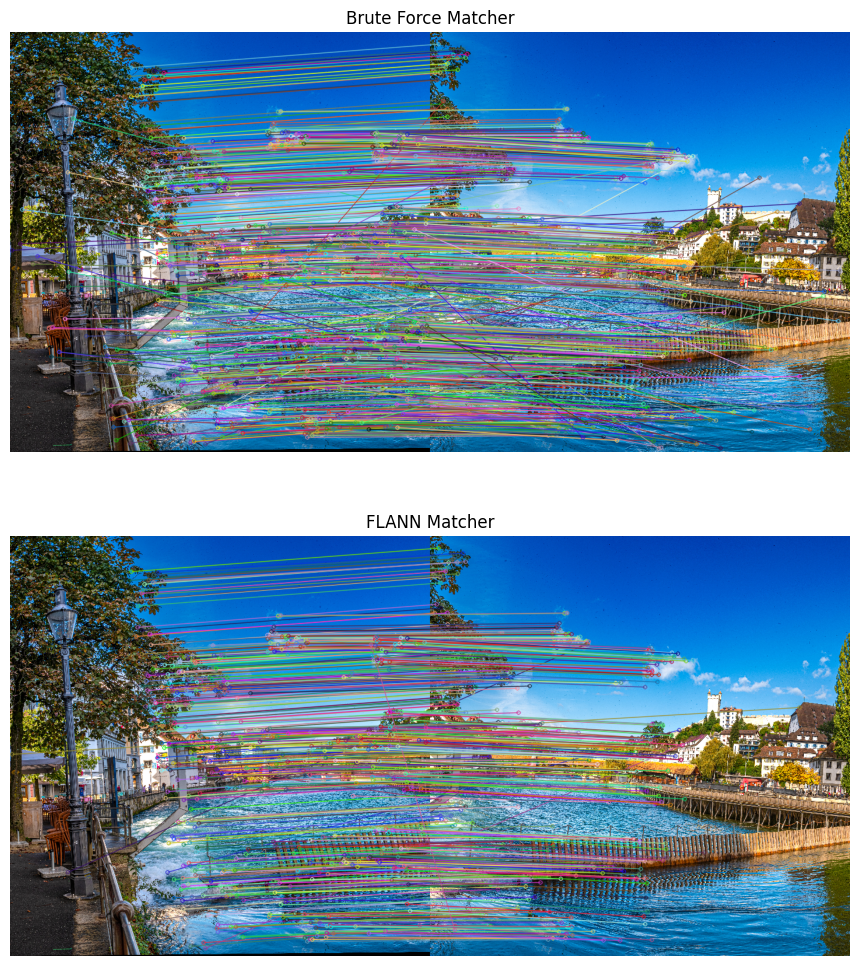

In [26]:
plt.figure(figsize=(18, 12))

plt.subplot(2, 1, 1)
plt.imshow(cv2.cvtColor(bf_matched, cv2.COLOR_BGR2RGB))
plt.title("Brute Force Matcher")
plt.axis("off")

plt.subplot(2, 1, 2)
plt.imshow(cv2.cvtColor(flann_matched, cv2.COLOR_BGR2RGB))
plt.title("FLANN Matcher")
plt.axis("off")

plt.show()

In [27]:
src_pts = np.float32([ keypoints1[m.queryIdx].pt for m in filtered_flann_matches]).reshape(-1,1,2)
dst_pts = np.float32([ keypoints2[m.trainIdx].pt for m in filtered_flann_matches]).reshape(-1,1,2)

In [28]:
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 0.1)


In [29]:
print(M)
homography_df = pd.DataFrame(M)
homography_df.to_csv("homography_matrix.csv", index=False)

print("Homography matrix saved as 'homography_matrix.csv'")

[[ 8.98085298e-01 -1.32630096e-01 -1.63930197e+02]
 [ 1.43784982e-01  9.88078715e-01 -6.93765571e+01]
 [ 1.50739776e-06 -6.92855471e-06  1.00000000e+00]]
Homography matrix saved as 'homography_matrix.csv'


In [30]:
np.savetxt('homography_matrix.csv', M, delimiter=',')


In [31]:
height, width = image2.shape[:2] 
warped_image1 = cv2.warpPerspective(image1, M, (width, height))
print(height,width)

720 720


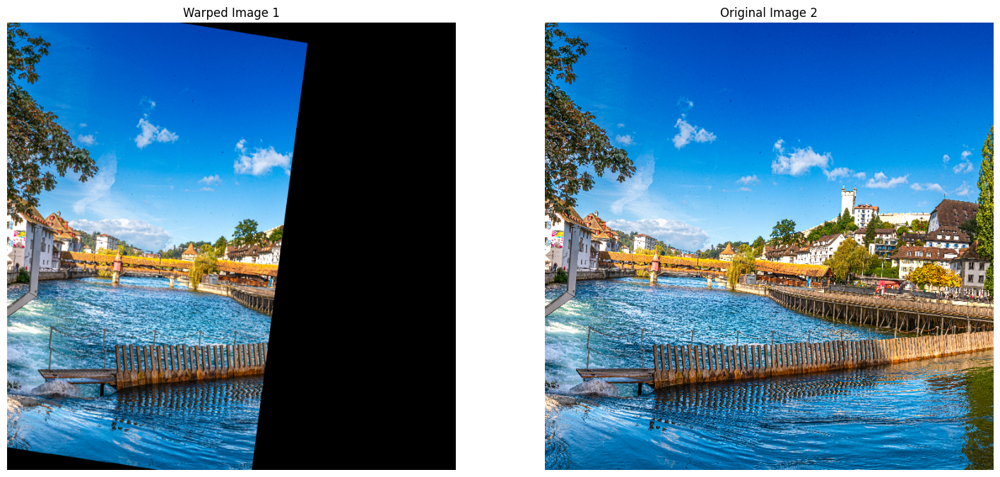

In [32]:
plt.figure(figsize=(18, 10))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(warped_image1, cv2.COLOR_BGR2RGB))
plt.title("Warped Image 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title("Original Image 2")
plt.axis("off")

plt.show()

In [33]:
panorama_no_crop = np.zeros((height, width + image1.shape[1], 3), dtype=np.uint8)


In [34]:
panorama_no_crop[:height, :width] = warped_image1
panorama_no_crop[:image2.shape[0], width:width + image2.shape[1]] = image2

In [35]:
non_zero_cols = np.where(np.any(panorama_no_crop != 0, axis=0))[0]
non_zero_rows = np.where(np.any(panorama_no_crop != 0, axis=1))[0]

In [36]:
panorama_cropped = panorama_no_crop[non_zero_rows[0]:non_zero_rows[-1] + 1,non_zero_cols[0]:non_zero_cols[-1] + 1]

(-0.5, 1439.5, 719.5, -0.5)

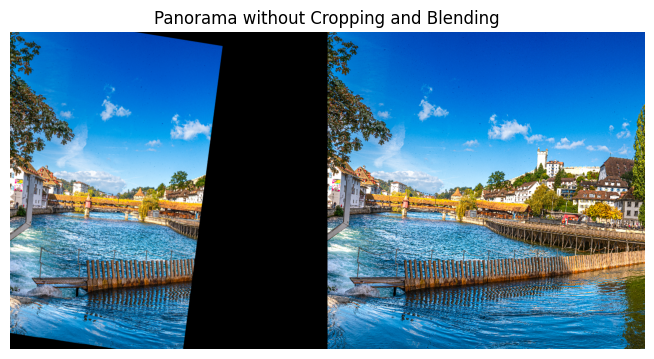

In [37]:
plt.figure(figsize=(18, 10))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(panorama_no_crop, cv2.COLOR_BGR2RGB))
plt.title("Panorama without Cropping and Blending")
plt.axis("off")

In [38]:
left_side = panorama_no_crop[:, :width]
right_side = panorama_no_crop[:, width:width + image2.shape[1]]

In [39]:
blended = cv2.addWeighted(left_side, 0.5, right_side, 0.5, 0.0)


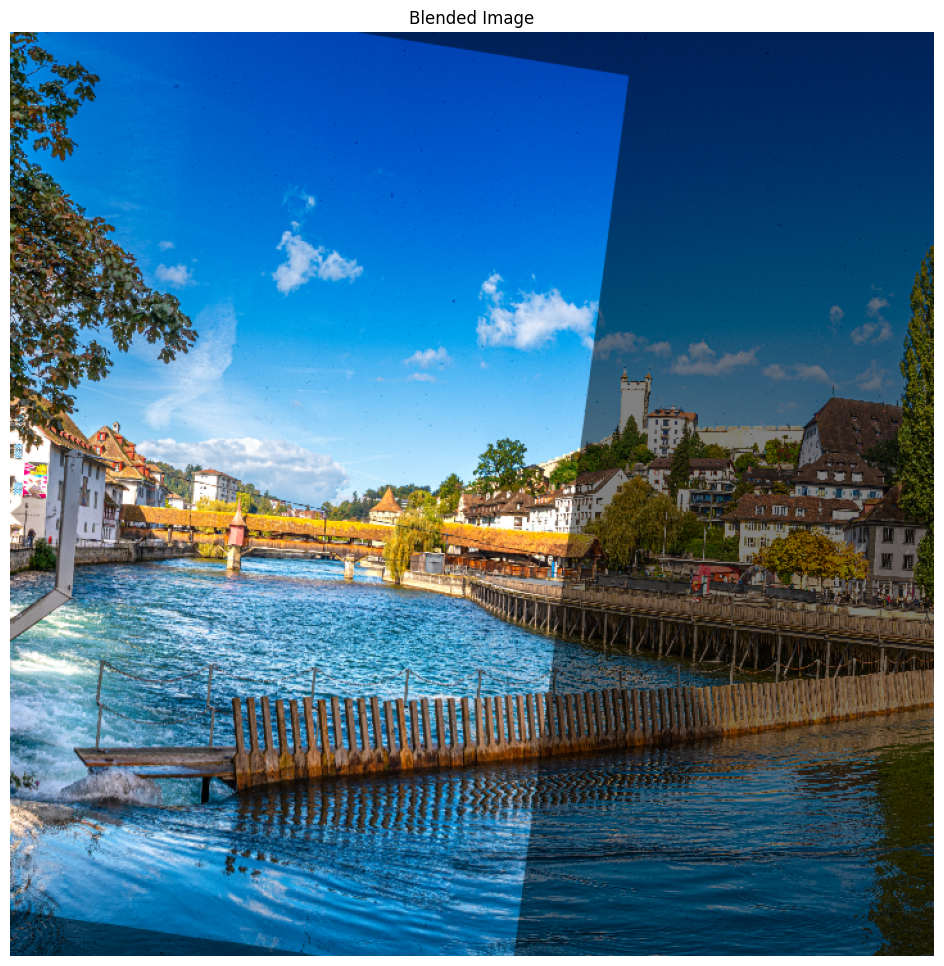

In [40]:
plt.figure(figsize=(18, 12))
plt.imshow(cv2.cvtColor(blended, cv2.COLOR_BGR2RGB))
plt.title("Blended Image")
plt.axis("off")
plt.show()

Stitching 8 images...


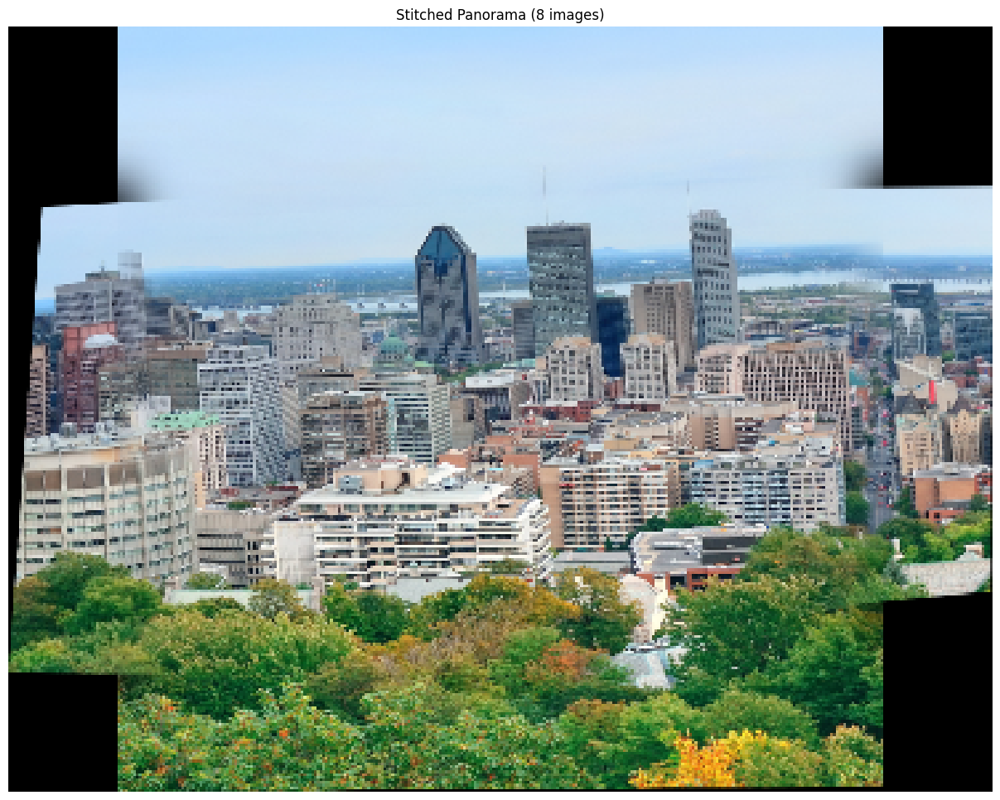

Panorama saved as 'panorama_result.jpg'


In [4]:

def load_and_sort_images(folder_path, resize_factor=0.5):
    """Load images from directory, sort them, and optionally resize"""
    images = []
    filenames = sorted([f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
    
    for filename in filenames:
        filepath = os.path.join(folder_path, filename)
        img = cv2.imread(filepath)
        if img is not None:
            if resize_factor != 1:
                img = cv2.resize(img, (0,0), fx=resize_factor, fy=resize_factor)
            images.append(img)
    
    if not images:
        raise ValueError("No valid images found in the directory")
    return images

def find_homography(img1, img2, min_matches=10):
    """Find homography matrix with quality checks"""
    orb = cv2.ORB_create(nfeatures=2000)
    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    
    if des1 is None or des2 is None:
        return None
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    
    if len(matches) < min_matches:
        return None
    
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
    
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    
    # Check if homography is valid
    if H is None or abs(H[2,0]) > 0.002 or abs(H[2,1]) > 0.002:
        return None
    
    return H

def create_canvas(image1, image2, H):
    """Create properly sized canvas for warping"""
    h1, w1 = image1.shape[:2]
    h2, w2 = image2.shape[:2]
    
    # Get the corners of both images
    corners1 = np.float32([[0,0], [0,h1], [w1,h1], [w1,0]]).reshape(-1,1,2)
    corners2 = np.float32([[0,0], [0,h2], [w2,h2], [w2,0]]).reshape(-1,1,2)
    
    # Warp the corners of image1
    warped_corners = cv2.perspectiveTransform(corners1, H)
    
    # Combine corners
    all_corners = np.concatenate((warped_corners, corners2), axis=0)
    
    # Find canvas dimensions
    [x_min, y_min] = np.int32(all_corners.min(axis=0).ravel() - 0.5)
    [x_max, y_max] = np.int32(all_corners.max(axis=0).ravel() + 0.5)
    
    # Calculate translation matrix
    tx, ty = -x_min, -y_min
    translation_matrix = np.array([[1, 0, tx], [0, 1, ty], [0, 0, 1]])
    
    # Adjust homography for translation
    H_adjusted = translation_matrix.dot(H)
    
    # Calculate canvas size
    canvas_width = int(x_max - x_min)
    canvas_height = int(y_max - y_min)
    
    return H_adjusted, canvas_width, canvas_height, tx, ty

def blend_images(warped, panorama):
    """Advanced blending with dynamic canvas and seam finding"""
    # Convert to grayscale for mask creation
    gray_warped = cv2.cvtColor(warped, cv2.COLOR_BGR2GRAY)
    gray_pano = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
    
    # Create mask (where warped image exists but panorama doesn't)
    mask = np.zeros_like(gray_warped, dtype=np.uint8)
    mask[(gray_warped > 0) & (gray_pano == 0)] = 255
    
    # Find contours in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Create a mask for blending area
    blend_mask = np.zeros_like(mask)
    cv2.drawContours(blend_mask, contours, -1, 255, -1)
    
    # Dilate the mask to include transition area
    kernel = np.ones((15,15), np.uint8)
    blend_mask = cv2.dilate(blend_mask, kernel, iterations=1)
    
    # Normalize the mask
    blend_mask = cv2.GaussianBlur(blend_mask, (51,51), 0)
    blend_mask = blend_mask.astype(np.float32) / 255.0
    blend_mask = cv2.merge([blend_mask, blend_mask, blend_mask])
    
    # Blend images
    blended = panorama * (1 - blend_mask) + warped * blend_mask
    
    # Where no blending occurs, take the maximum value
    final = np.where(panorama == 0, warped, blended)
    
    return final.astype(np.uint8)

def stitch_multiple_images(images):
    """Stitch multiple images with reference-based approach"""
    if len(images) < 2:
        raise ValueError("Need at least 2 images to stitch")
    
    # Convert all images to same color space
    images = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) if len(img.shape) == 3 else img for img in images]
    
    # Use middle image as reference
    ref_idx = len(images) // 2
    panorama = images[ref_idx].copy()
    
    # Stitch images to the left of reference
    for img in reversed(images[:ref_idx]):
        H = find_homography(img, panorama)
        if H is None:
            continue
            
        H_adj, canvas_w, canvas_h, tx, ty = create_canvas(img, panorama, H)
        
        # Warp the new image
        warped = cv2.warpPerspective(img, H_adj, (canvas_w, canvas_h))
        
        # Create panorama canvas
        pano_canvas = np.zeros((canvas_h, canvas_w, 3), dtype=np.uint8)
        pano_canvas[ty:ty+panorama.shape[0], tx:tx+panorama.shape[1]] = panorama
        
        # Blend images
        panorama = blend_images(warped, pano_canvas)
    
    # Stitch images to the right of reference
    for img in images[ref_idx+1:]:
        H = find_homography(img, panorama)
        if H is None:
            continue
            
        H_adj, canvas_w, canvas_h, tx, ty = create_canvas(img, panorama, H)
        
        # Warp the new image
        warped = cv2.warpPerspective(img, H_adj, (canvas_w, canvas_h))
        
        # Create panorama canvas
        pano_canvas = np.zeros((canvas_h, canvas_w, 3), dtype=np.uint8)
        pano_canvas[ty:ty+panorama.shape[0], tx:tx+panorama.shape[1]] = panorama
        
        # Blend images
        panorama = blend_images(warped, pano_canvas)
    
    # Final crop
    gray = cv2.cvtColor(panorama, cv2.COLOR_RGB2GRAY)
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        x,y,w,h = cv2.boundingRect(contours[0])
        panorama = panorama[y:y+h, x:x+w]
    
    return panorama

# Main execution
if __name__ == "__main__":
    try:
        # Load and prepare images
        folder_path = '/kaggle/working/clustered_images/cluster_1'
        images = load_and_sort_images(folder_path, resize_factor=0.4)
        
        # Stitch images
        print(f"Stitching {len(images)} images...")
        result = stitch_multiple_images(images)
        
        # Display results
        plt.figure(figsize=(18, 12))
        plt.imshow(result)
        plt.title(f"Stitched Panorama ({len(images)} images)")
        plt.axis("off")
        plt.show()
        
        # Save result
        cv2.imwrite('panorama_result.jpg', cv2.cvtColor(result, cv2.COLOR_RGB2BGR))
        print("Panorama saved as 'panorama_result.jpg'")
        
    except Exception as e:
        print(f"Error: {str(e)}")

Stitching 8 images...


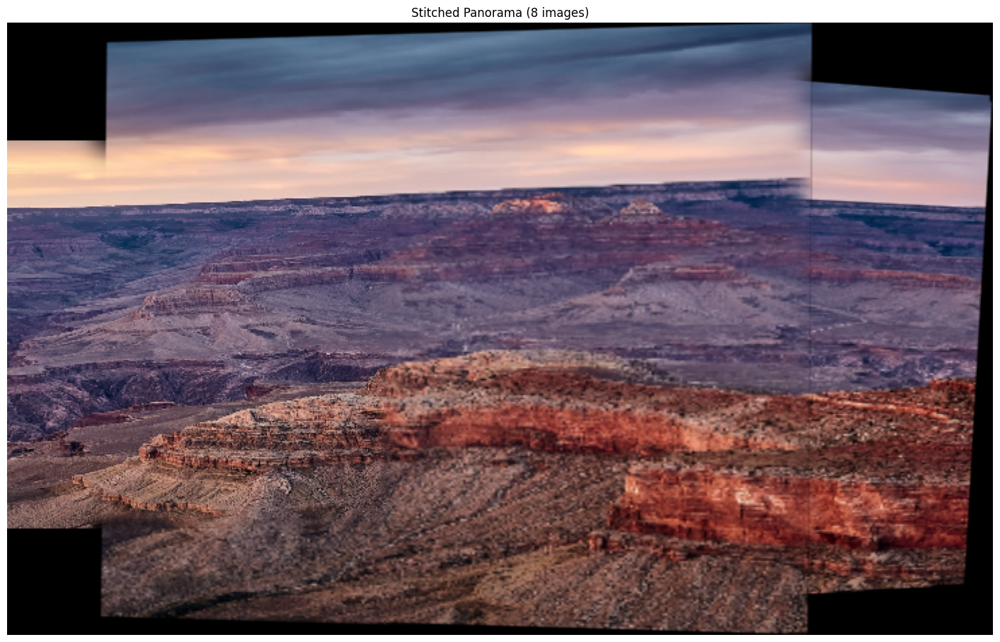

Panorama saved as 'panorama_result.jpg'


In [5]:

def load_and_sort_images(folder_path, resize_factor=0.5):
    """Load images from directory, sort them, and optionally resize"""
    images = []
    filenames = sorted([f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
    
    for filename in filenames:
        filepath = os.path.join(folder_path, filename)
        img = cv2.imread(filepath)
        if img is not None:
            if resize_factor != 1:
                img = cv2.resize(img, (0,0), fx=resize_factor, fy=resize_factor)
            images.append(img)
    
    if not images:
        raise ValueError("No valid images found in the directory")
    return images

def find_homography(img1, img2, min_matches=10):
    """Find homography matrix with quality checks"""
    orb = cv2.ORB_create(nfeatures=2000)
    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    
    if des1 is None or des2 is None:
        return None
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    
    if len(matches) < min_matches:
        return None
    
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
    
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    
    # Check if homography is valid
    if H is None or abs(H[2,0]) > 0.002 or abs(H[2,1]) > 0.002:
        return None
    
    return H

def create_canvas(image1, image2, H):
    """Create properly sized canvas for warping"""
    h1, w1 = image1.shape[:2]
    h2, w2 = image2.shape[:2]
    
    # Get the corners of both images
    corners1 = np.float32([[0,0], [0,h1], [w1,h1], [w1,0]]).reshape(-1,1,2)
    corners2 = np.float32([[0,0], [0,h2], [w2,h2], [w2,0]]).reshape(-1,1,2)
    
    # Warp the corners of image1
    warped_corners = cv2.perspectiveTransform(corners1, H)
    
    # Combine corners
    all_corners = np.concatenate((warped_corners, corners2), axis=0)
    
    # Find canvas dimensions
    [x_min, y_min] = np.int32(all_corners.min(axis=0).ravel() - 0.5)
    [x_max, y_max] = np.int32(all_corners.max(axis=0).ravel() + 0.5)
    
    # Calculate translation matrix
    tx, ty = -x_min, -y_min
    translation_matrix = np.array([[1, 0, tx], [0, 1, ty], [0, 0, 1]])
    
    # Adjust homography for translation
    H_adjusted = translation_matrix.dot(H)
    
    # Calculate canvas size
    canvas_width = int(x_max - x_min)
    canvas_height = int(y_max - y_min)
    
    return H_adjusted, canvas_width, canvas_height, tx, ty

def blend_images(warped, panorama):
    """Advanced blending with dynamic canvas and seam finding"""
    # Convert to grayscale for mask creation
    gray_warped = cv2.cvtColor(warped, cv2.COLOR_BGR2GRAY)
    gray_pano = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
    
    # Create mask (where warped image exists but panorama doesn't)
    mask = np.zeros_like(gray_warped, dtype=np.uint8)
    mask[(gray_warped > 0) & (gray_pano == 0)] = 255
    
    # Find contours in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Create a mask for blending area
    blend_mask = np.zeros_like(mask)
    cv2.drawContours(blend_mask, contours, -1, 255, -1)
    
    # Dilate the mask to include transition area
    kernel = np.ones((15,15), np.uint8)
    blend_mask = cv2.dilate(blend_mask, kernel, iterations=1)
    
    # Normalize the mask
    blend_mask = cv2.GaussianBlur(blend_mask, (51,51), 0)
    blend_mask = blend_mask.astype(np.float32) / 255.0
    blend_mask = cv2.merge([blend_mask, blend_mask, blend_mask])
    
    # Blend images
    blended = panorama * (1 - blend_mask) + warped * blend_mask
    
    # Where no blending occurs, take the maximum value
    final = np.where(panorama == 0, warped, blended)
    
    return final.astype(np.uint8)

def stitch_multiple_images(images):
    """Stitch multiple images with reference-based approach"""
    if len(images) < 2:
        raise ValueError("Need at least 2 images to stitch")
    
    # Convert all images to same color space
    images = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) if len(img.shape) == 3 else img for img in images]
    
    # Use middle image as reference
    ref_idx = len(images) // 2
    panorama = images[ref_idx].copy()
    
    # Stitch images to the left of reference
    for img in reversed(images[:ref_idx]):
        H = find_homography(img, panorama)
        if H is None:
            continue
            
        H_adj, canvas_w, canvas_h, tx, ty = create_canvas(img, panorama, H)
        
        # Warp the new image
        warped = cv2.warpPerspective(img, H_adj, (canvas_w, canvas_h))
        
        # Create panorama canvas
        pano_canvas = np.zeros((canvas_h, canvas_w, 3), dtype=np.uint8)
        pano_canvas[ty:ty+panorama.shape[0], tx:tx+panorama.shape[1]] = panorama
        
        # Blend images
        panorama = blend_images(warped, pano_canvas)
    
    # Stitch images to the right of reference
    for img in images[ref_idx+1:]:
        H = find_homography(img, panorama)
        if H is None:
            continue
            
        H_adj, canvas_w, canvas_h, tx, ty = create_canvas(img, panorama, H)
        
        # Warp the new image
        warped = cv2.warpPerspective(img, H_adj, (canvas_w, canvas_h))
        
        # Create panorama canvas
        pano_canvas = np.zeros((canvas_h, canvas_w, 3), dtype=np.uint8)
        pano_canvas[ty:ty+panorama.shape[0], tx:tx+panorama.shape[1]] = panorama
        
        # Blend images
        panorama = blend_images(warped, pano_canvas)
    
    # Final crop
    gray = cv2.cvtColor(panorama, cv2.COLOR_RGB2GRAY)
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        x,y,w,h = cv2.boundingRect(contours[0])
        panorama = panorama[y:y+h, x:x+w]
    
    return panorama

# Main execution
if __name__ == "__main__":
    try:
        # Load and prepare images
        folder_path = '/kaggle/working/clustered_images/cluster_2'
        images = load_and_sort_images(folder_path, resize_factor=0.4)
        
        # Stitch images
        print(f"Stitching {len(images)} images...")
        result = stitch_multiple_images(images)
        
        # Display results
        plt.figure(figsize=(18, 12))
        plt.imshow(result)
        plt.title(f"Stitched Panorama ({len(images)} images)")
        plt.axis("off")
        plt.show()
        
        # Save result
        cv2.imwrite('panorama_result.jpg', cv2.cvtColor(result, cv2.COLOR_RGB2BGR))
        print("Panorama saved as 'panorama_result.jpg'")
        
    except Exception as e:
        print(f"Error: {str(e)}")

Stitching 8 images...


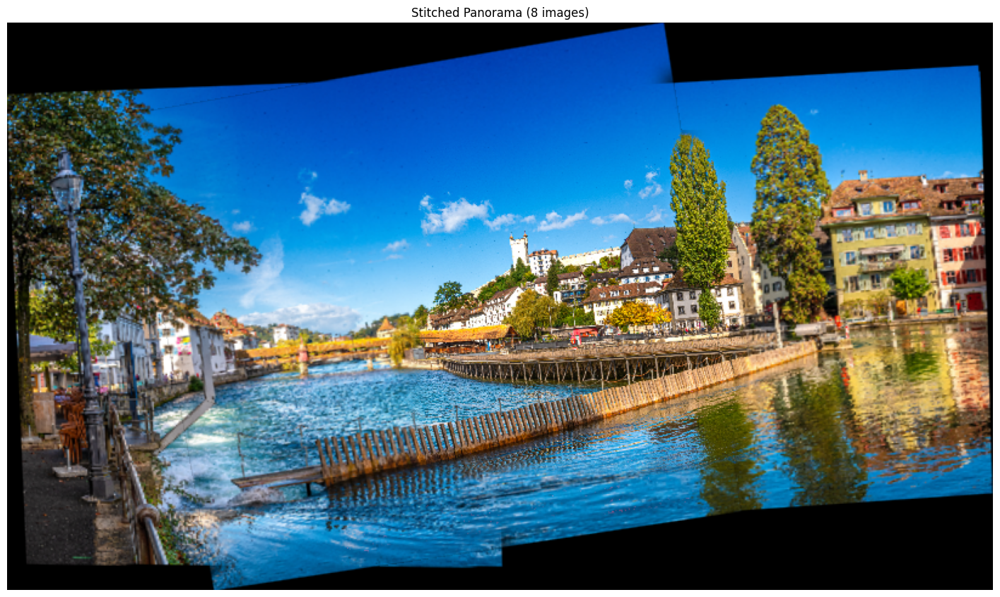

Panorama saved as 'panorama_result.jpg'


In [6]:

def load_and_sort_images(folder_path, resize_factor=0.5):
    """Load images from directory, sort them, and optionally resize"""
    images = []
    filenames = sorted([f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
    
    for filename in filenames:
        filepath = os.path.join(folder_path, filename)
        img = cv2.imread(filepath)
        if img is not None:
            if resize_factor != 1:
                img = cv2.resize(img, (0,0), fx=resize_factor, fy=resize_factor)
            images.append(img)
    
    if not images:
        raise ValueError("No valid images found in the directory")
    return images

def find_homography(img1, img2, min_matches=10):
    """Find homography matrix with quality checks"""
    orb = cv2.ORB_create(nfeatures=2000)
    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    
    if des1 is None or des2 is None:
        return None
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    
    if len(matches) < min_matches:
        return None
    
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
    
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    
    # Check if homography is valid
    if H is None or abs(H[2,0]) > 0.002 or abs(H[2,1]) > 0.002:
        return None
    
    return H

def create_canvas(image1, image2, H):
    """Create properly sized canvas for warping"""
    h1, w1 = image1.shape[:2]
    h2, w2 = image2.shape[:2]
    
    # Get the corners of both images
    corners1 = np.float32([[0,0], [0,h1], [w1,h1], [w1,0]]).reshape(-1,1,2)
    corners2 = np.float32([[0,0], [0,h2], [w2,h2], [w2,0]]).reshape(-1,1,2)
    
    # Warp the corners of image1
    warped_corners = cv2.perspectiveTransform(corners1, H)
    
    # Combine corners
    all_corners = np.concatenate((warped_corners, corners2), axis=0)
    
    # Find canvas dimensions
    [x_min, y_min] = np.int32(all_corners.min(axis=0).ravel() - 0.5)
    [x_max, y_max] = np.int32(all_corners.max(axis=0).ravel() + 0.5)
    
    # Calculate translation matrix
    tx, ty = -x_min, -y_min
    translation_matrix = np.array([[1, 0, tx], [0, 1, ty], [0, 0, 1]])
    
    # Adjust homography for translation
    H_adjusted = translation_matrix.dot(H)
    
    # Calculate canvas size
    canvas_width = int(x_max - x_min)
    canvas_height = int(y_max - y_min)
    
    return H_adjusted, canvas_width, canvas_height, tx, ty

def blend_images(warped, panorama):
    """Advanced blending with dynamic canvas and seam finding"""
    # Convert to grayscale for mask creation
    gray_warped = cv2.cvtColor(warped, cv2.COLOR_BGR2GRAY)
    gray_pano = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
    
    # Create mask (where warped image exists but panorama doesn't)
    mask = np.zeros_like(gray_warped, dtype=np.uint8)
    mask[(gray_warped > 0) & (gray_pano == 0)] = 255
    
    # Find contours in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Create a mask for blending area
    blend_mask = np.zeros_like(mask)
    cv2.drawContours(blend_mask, contours, -1, 255, -1)
    
    # Dilate the mask to include transition area
    kernel = np.ones((15,15), np.uint8)
    blend_mask = cv2.dilate(blend_mask, kernel, iterations=1)
    
    # Normalize the mask
    blend_mask = cv2.GaussianBlur(blend_mask, (51,51), 0)
    blend_mask = blend_mask.astype(np.float32) / 255.0
    blend_mask = cv2.merge([blend_mask, blend_mask, blend_mask])
    
    # Blend images
    blended = panorama * (1 - blend_mask) + warped * blend_mask
    
    # Where no blending occurs, take the maximum value
    final = np.where(panorama == 0, warped, blended)
    
    return final.astype(np.uint8)

def stitch_multiple_images(images):
    """Stitch multiple images with reference-based approach"""
    if len(images) < 2:
        raise ValueError("Need at least 2 images to stitch")
    
    # Convert all images to same color space
    images = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) if len(img.shape) == 3 else img for img in images]
    
    # Use middle image as reference
    ref_idx = len(images) // 2
    panorama = images[ref_idx].copy()
    
    # Stitch images to the left of reference
    for img in reversed(images[:ref_idx]):
        H = find_homography(img, panorama)
        if H is None:
            continue
            
        H_adj, canvas_w, canvas_h, tx, ty = create_canvas(img, panorama, H)
        
        # Warp the new image
        warped = cv2.warpPerspective(img, H_adj, (canvas_w, canvas_h))
        
        # Create panorama canvas
        pano_canvas = np.zeros((canvas_h, canvas_w, 3), dtype=np.uint8)
        pano_canvas[ty:ty+panorama.shape[0], tx:tx+panorama.shape[1]] = panorama
        
        # Blend images
        panorama = blend_images(warped, pano_canvas)
    
    # Stitch images to the right of reference
    for img in images[ref_idx+1:]:
        H = find_homography(img, panorama)
        if H is None:
            continue
            
        H_adj, canvas_w, canvas_h, tx, ty = create_canvas(img, panorama, H)
        
        # Warp the new image
        warped = cv2.warpPerspective(img, H_adj, (canvas_w, canvas_h))
        
        # Create panorama canvas
        pano_canvas = np.zeros((canvas_h, canvas_w, 3), dtype=np.uint8)
        pano_canvas[ty:ty+panorama.shape[0], tx:tx+panorama.shape[1]] = panorama
        
        # Blend images
        panorama = blend_images(warped, pano_canvas)
    
    # Final crop
    gray = cv2.cvtColor(panorama, cv2.COLOR_RGB2GRAY)
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        x,y,w,h = cv2.boundingRect(contours[0])
        panorama = panorama[y:y+h, x:x+w]
    
    return panorama

# Main execution
if __name__ == "__main__":
    try:
        # Load and prepare images
        folder_path = '/kaggle/working/clustered_images/cluster_3'
        images = load_and_sort_images(folder_path, resize_factor=0.4)
        
        # Stitch images
        print(f"Stitching {len(images)} images...")
        result = stitch_multiple_images(images)
        
        # Display results
        plt.figure(figsize=(18, 12))
        plt.imshow(result)
        plt.title(f"Stitched Panorama ({len(images)} images)")
        plt.axis("off")
        plt.show()
        
        # Save result
        cv2.imwrite('panorama_result.jpg', cv2.cvtColor(result, cv2.COLOR_RGB2BGR))
        print("Panorama saved as 'panorama_result.jpg'")
        
    except Exception as e:
        print(f"Error: {str(e)}")